# Inferring Disposable Income from Property Value and Supermarket Proximity

This notebook is part of my capstone project for the IBM DataScience Professional Certificate.

In [1]:
from IPython.display import Image

# Introduction


If you’d ever been shopping for groceries in the UK you wouldn’t need a statistical genius to tell you which of the two towns illustrated below probably had the highest disposable income. We don’t need to know anything about the household earnings to form an opinion based on the average property price and the presence of certain supermarkets. 


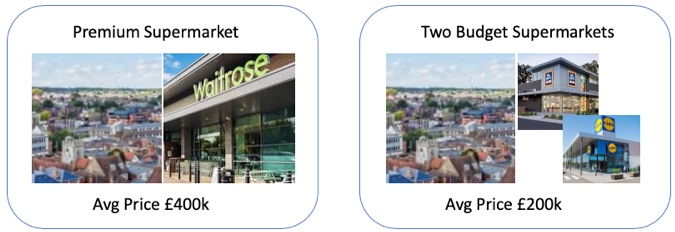

In [2]:
Image('img/towns.jpg')

Beyond this intuitive understanding is it possible to quantify this somehow by applying machine learning? Can we leverage the detailed analysis performed by the supermarket chains themselves to infer anything about disposable income? 

Grocery shopping is dominated by large supermarket chains, but they target different customer segments. Premium supermarkets are operated by Waitrose, mainstream supermarkets are operated by Tesco, Sainsburys, Asda and Morrisons. Budget supermarkets are operated by Lidl and Aldi. Can we leverage the detailed analysis performed by these supermarket chains that led to them to open stores in some areas and not others to infer anything about these areas in terms of disposable income? 

This project will analyse towns and cities in England and Wales to see if any insights into disposable income can be derived from presence of certain supermarkets combined with property values. The presence of a supermarket can raise property prices, so the two features being analysed aren’t truly independent. A study by Lloyds bank in 2017 suggested that a Waitrose can add as much as £36k to local property prices. £22k for a mainstream supermarket and £6k for a budget supermarket [1].


# Data

This project will use property transaction data published by the UK Govt Land Registry on Kaggle, combined with geolocation data from Google, augmented with location insights provided by FourSquare. 

## Property Transaction Data

The Kaggle dataset is here [UK Housing Prices Paid | Kaggle](https://www.kaggle.com/hm-land-registry/uk-housing-prices-paid)

I have downloaded this file to my local workstation.

In [3]:
import types
import pandas as pd


price_data = pd.read_csv('price_paid_records.csv')

There is 2.2 GB of data in the complete dataset, containing property transactions from 1995 until 2017. An example of the data is shown below.

In [4]:
price_data.head()

,Transaction unique identifier,Price,Date of Transfer,Property Type,Old/New,Duration,Town/City,District,County,PPDCategory Type,Record Status - monthly file only
0,{81B82214-7FBC-4129-9F6B-4956B4A663AD},25000,1995-08-18 00:00,T,N,F,OLDHAM,OLDHAM,GREATER MANCHESTER,A,A
1,{8046EC72-1466-42D6-A753-4956BF7CD8A2},42500,1995-08-09 00:00,S,N,F,GRAYS,THURROCK,THURROCK,A,A
2,{278D581A-5BF3-4FCE-AF62-4956D87691E6},45000,1995-06-30 00:00,T,N,F,HIGHBRIDGE,SEDGEMOOR,SOMERSET,A,A
3,{1D861C06-A416-4865-973C-4956DB12CD12},43150,1995-11-24 00:00,T,N,F,BEDFORD,NORTH BEDFORDSHIRE,BEDFORDSHIRE,A,A
4,{DD8645FD-A815-43A6-A7BA-4956E58F1874},18899,1995-06-23 00:00,S,N,F,WAKEFIELD,LEEDS,WEST YORKSHIRE,A,A


In [5]:
price_data.shape

(22489348, 11)

For this project we are interested in the price, the transaction date, the town, district and county. One significant limitation of the data is that precise location data isn’t provided, we have to infer the location from town, district in county. This is rather imprecise for large cities resulting in a lack of detail for any large city such as Birmingham, London or Liverpool as shown above.

## Geolocation Data
Google provides a geolocation API as part of the Google Maps platform [3]. Given an address, the geolocation API will try to provide a precise latitude and longitude even if the address is ambiguous or incomplete. The example response below shows the location information returned by the API for Google’s head office.

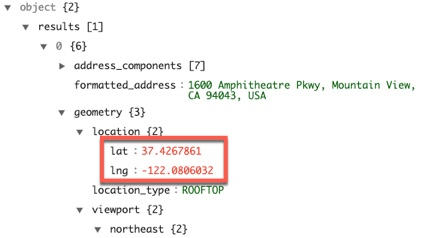

In [6]:

Image('img/google.jpg')


## Venue Data
The FourSquare Places API provides details of venues within a radius of a given location [4]. This can be a general search or a search within a specific category of venue such as a supermarket. For the purposes of this exercise I was searching for supermarket venues within a 3000 meter radius of a given longitude and latitude.   

The example below shows the search result for Morpeth in Northumberland. 
  


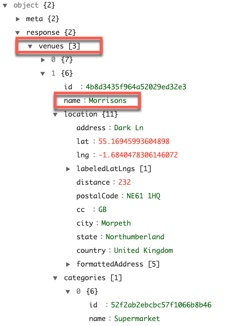

In [7]:
Image('img/venue.jpg')

For this search there were 3 venues found within the search radius where the category was supermarket. I’ve expanded the second result which is for a Morrisons supermarket. 

# Methodology

These are the steps taken to process the data and apply clustering to the data. Each step is described in further detail.

* Step 1 - Exploratory Data Analysis
* Step 2 - Preparing the Data
* Step 3 - Enriching the Data and Feature Engineering
* Step 4 - Clustering the Data


## Step 1 - Exploratory Data Analysis

There is 2.2 GB of data in the complete dataset, containing all property transactions from 1995 until 2017. We are only interested in recent data as it isn’t easy to accurately estimate a property’s value today from a transaction that took place 20 years ago, we will only include sales after 2013. We’ll also remove any outliers as these could skew the average price in a given tow, we only include transactions between £60,000 and £1,000,000 but there are still 3.2m transactions.

In [9]:
#Add a year column
price_data['year'] = pd.DatetimeIndex(price_data['Date of Transfer']).year
price_data.head()

,Transaction unique identifier,Price,Date of Transfer,Property Type,Old/New,Duration,Town/City,District,County,PPDCategory Type,Record Status - monthly file only,year
0,{81B82214-7FBC-4129-9F6B-4956B4A663AD},25000,1995-08-18 00:00,T,N,F,OLDHAM,OLDHAM,GREATER MANCHESTER,A,A,1995
1,{8046EC72-1466-42D6-A753-4956BF7CD8A2},42500,1995-08-09 00:00,S,N,F,GRAYS,THURROCK,THURROCK,A,A,1995
2,{278D581A-5BF3-4FCE-AF62-4956D87691E6},45000,1995-06-30 00:00,T,N,F,HIGHBRIDGE,SEDGEMOOR,SOMERSET,A,A,1995
3,{1D861C06-A416-4865-973C-4956DB12CD12},43150,1995-11-24 00:00,T,N,F,BEDFORD,NORTH BEDFORDSHIRE,BEDFORDSHIRE,A,A,1995
4,{DD8645FD-A815-43A6-A7BA-4956E58F1874},18899,1995-06-23 00:00,S,N,F,WAKEFIELD,LEEDS,WEST YORKSHIRE,A,A,1995


In [10]:
#Convert the year to an int
price_data = price_data.astype({"year": int})

#Create a new dataframe by filtering by year
recent_price_data = price_data.loc[price_data['year'] > 2013]
recent_price_data.shape

(3398020, 12)

In [11]:
# Remove any outliers

recent_price_data['Price'] = recent_price_data['Price'].astype(str).astype(int)
recent_price_data = recent_price_data.loc[(recent_price_data['Price'] < (1000000)) & (recent_price_data['Price'] > (60000)),]
len(recent_price_data)


3212217

In [12]:
# Dereference the raw data to save memory
price_data = ''

Our data now contains transactions after 2014, between £60,000 and £1,000,000 but there are still 3.2m transactions

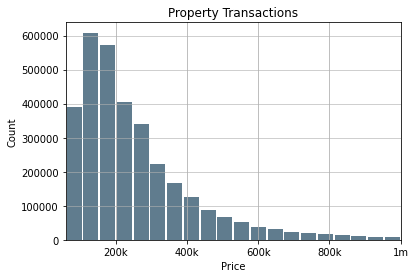

In [13]:
import matplotlib.pyplot as plt 

recent_price_data['Price'].hist(grid=True, bins=20, rwidth=0.9,
                   color='#607c8e')
plt.title('Property Transactions')
plt.xlabel('Price')
plt.xlim(60000,1000000)
plt.xticks(ticks = [200000,400000,600000,800000,1000000], labels=['200k', '400k','600k','800k','1m'])
plt.ylabel('Count')

plt.grid(axis='y', alpha=0.75)

In [14]:
recent_price_data['Price'].describe().apply("{0:,.0f}".format)

count    3,212,217
mean       251,819
std        161,632
min         60,001
25%        139,000
50%        206,000
75%        315,000
max        999,999
Name: Price, dtype: object

For simplicity we will calculate the average property price for any area regardless of property type, but it should be noted that there is a difference even if there is a lot of overlap. 

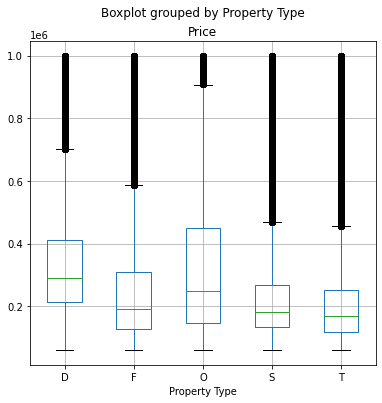

In [15]:
recent_price_data.boxplot(column = 'Price', by = 'Property Type', figsize=(6,6))

On average flats and apartments are cheaper than terraced houses, terraced houses are cheaper than semi-detached houses, which in turn are cheaper than detached houses.

## Step 2 - Preparing the Data

To prepare the data we'll remove columns we don't need and calculte the average price for each town in the dataset.

In [16]:
#Remove the columns we don't need from the price data
columns_to_drop = ['Transaction unique identifier', 'Date of Transfer', 'Old/New', 'Duration', 'PPDCategory Type', 'Record Status - monthly file only', 'Property Type', 'year']
recent_price_data.drop(columns_to_drop, inplace=True, axis=1)


In [17]:
recent_price_data.reset_index(drop=True)
recent_price_data.shape

(3212217, 4)

In [18]:
#combine the the town and county into a single field

recent_price_data['Location'] = recent_price_data['Town/City'] + ', ' + recent_price_data['County']

In [19]:
#Remove the town, district and county
columns_to_drop = ['Town/City', 'District', 'County']
recent_price_data.drop(columns_to_drop, inplace=True, axis=1)

In [20]:
recent_price_data.head()

,Price,Location
19091329,93000,"SWINDON, SWINDON"
19091330,150000,"LIVERPOOL, MERSEYSIDE"
19091331,247000,"SAFFRON WALDEN, ESSEX"
19091333,239950,"SWINDON, SWINDON"
19091334,209950,"ASHFORD, KENT"


### Average Price By Town
We now how our UK pricing data grouped by town, district and county with the average price since 2014. 

In [21]:
# Now group by area and calculate the mean
data_grouped  = pd.DataFrame(recent_price_data.groupby(['Location'])['Price'].mean().reset_index())
data_grouped['Price'] = data_grouped['Price'].astype(int)
data_grouped.head()

,Location,Price
0,"ABBOTS LANGLEY, HERTFORDSHIRE",385440
1,"ABERAERON, CEREDIGION",203232
2,"ABERDARE, POWYS",292083
3,"ABERDARE, RHONDDA CYNON TAFF",128941
4,"ABERDOVEY, GWYNEDD",282213


In [22]:
data_grouped.shape

(1941, 2)

## Step 3 - Enriching the Data and Feature Engineering
Enrichment was comprised of three stages for each town in the dataset. 

1.	Determine the precise longitude and latitude of the town.
2.	Use the precise location the search for supermarkets within a 3km radius
3.	Aggregate the supermarkets together and derive a score for the town. 

Stages 1 & 2 used public API’s from Google [3] and FourSquare [4] respectively.


### Google Geolocation

In [23]:
#Using Google maps for the geolocation 
#This requires an API key which is set in a hidden cell

!pip install googlemaps

import googlemaps

You are using pip version 19.0.3, however version 20.2b1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [24]:
# @hidden_cell
google_key=''

In [25]:
gmaps = googlemaps.Client(key=google_key)

Create a new dataframe with the lat & lon

In [26]:
# define the dataframe columns
column_names = ['Location', 'Avg Price', 'Latitude', 'Longitude'] 

# instantiate the dataframe
towns = pd.DataFrame(columns=column_names)

In [27]:
for index, row in data_grouped.iterrows():

    location = row['Location']
    avg_price = row['Price']
    
    geocode_result = gmaps.geocode('{}, UK'.format(location))  
    
    #If we don't find the location just skip it
    if geocode_result != []:
 
      lat = geocode_result[0]['geometry']['location']['lat']
      lng = geocode_result[0]['geometry']['location']['lng']

      towns = towns.append({'Location': location,
                          'Avg Price': avg_price,
                            'Latitude': lat,
                            'Longitude': lng}, ignore_index=True)

In [ ]:
# Save the towns dataframe in case you want to relead it.

towns.to_csv('towns.csv')



Use FourSquare to Find Nearby Supermarkets

In [28]:
import requests # library to handle requests
import pandas as pd
from pandas.io.json import json_normalize

In [29]:
# For Dev Load Towns
towns = pd.read_csv('towns.csv')

In [30]:
# @hidden_cell
CLIENT_ID = '' # your Foursquare ID
CLIENT_SECRET = '' # your Foursquare Secret
VERSION = '20200520'
LIMIT = 30
categoryId = '52f2ab2ebcbc57f1066b8b46'
radius = 3000




In [ ]:
Perform feature engineering, that is, creating a new feature by applying domain knowledge to existing features. The goal was to create a score that reflected the makeup of supermarkets in a given town, a higher score would be given for premium and mainstream supermarkets, a score would be lowered if there were budget supermarkets nearby.

This required counting the occurrences of each type of supermarket within a town and producing an aggregate score. Any premium supermarket (Waitrose) was given a score of 5, mainstream supermarkets were given a score of 3 and the budget supermarkets were given a score of 1.  An average score called Profile Score was calculated and then added to the dataset.


In [31]:
# Iterate through the towns to find their supermarkets
# Add this information to the dataframe
# Derive a scrore for each town based on supermarkets
# define the dataframe columns
column_names = ['Location', 'Avg Price', 'Latitude', 'Longitude', 'Profile Score', 'Profile'] 

# instantiate the dataframe
towns_supermarkets = pd.DataFrame(columns=column_names)

for index, row in towns.iterrows():
    location = row['Location']
    avg_price = row['Avg Price']
    lat = row['Latitude']
    lon = row['Longitude']
    
    nearby_supermarkets = pd.DataFrame()

    #Initialise a base score for profile
    profile = ''
    profile_score = 0
    count = 0
              
    
    #Call FourSquare here with the lat & lon looking for supermarkets only
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&categoryId={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, lat, lon, VERSION, categoryId, radius, LIMIT)

    try:
        results = requests.get(url).json()["response"]['venues']
        nearby_supermarkets = json_normalize(results) # flatten JSON
    except:
        nearby_supermarkets = pd.DataFrame()

    if nearby_supermarkets.empty != True:
        supermarkets = nearby_supermarkets.name.unique()
      
        if "Waitrose & Partners" in supermarkets:
            profile_score = profile_score + 5
            profile = profile + 'W'
            count = count +1
    
        if "Sainsbury's" in supermarkets:
            profile_score = profile_score + 3
            profile = profile + 'S'
            count = count +1

        if "Tesco" in supermarkets:
            profile_score = profile_score + 3
            profile = profile + 'T'
            count = count +1

        if "Asda" in supermarkets:
            profile_score = profile_score + 3
            profile = profile + 'D'
            count = count +1

        if "Morrisons" in supermarkets:
            profile_score = profile_score + 3
            profile = profile + 'M'
            count = count +1

        if "Lidl" in supermarkets:
            profile_score = profile_score + 1
            profile = profile + 'L'
            count = count +1

        if "Aldi" in supermarkets:
            profile_score = profile_score + 1
            profile = profile + 'A'
            count = count +1

    


    #Calculate the profile score if any supermarkets were found
    if count > 0:
        profile_score = profile_score / count
    
        #Only include locations that have a supermarket
        towns_supermarkets = towns_supermarkets.append({'Location': location,
                                                            'Avg Price': avg_price,
                                                            'Latitude': lat,
                                                            'Longitude': lon,
                                                            'Profile Score': profile_score, 
                                                            'Profile' : profile
                                                            }, ignore_index=True)

In [32]:
towns_supermarkets.head()

,Location,Avg Price,Latitude,Longitude,Profile Score,Profile
0,"ABERDARE, POWYS",292083,51.716154,-3.451816,2.333333,TDL
1,"ABERDARE, RHONDDA CYNON TAFF",128941,51.716154,-3.451816,2.333333,TDL
2,"ABERGAVENNY, BLAENAU GWENT",260000,51.771443,-3.245874,2.000000,TMLA
3,"ABERGAVENNY, CARDIFF",180000,51.822003,-3.019804,3.000000,WMA
4,"ABERGAVENNY, MONMOUTHSHIRE",236046,51.825366,-3.019423,3.000000,WMA


In [ ]:
towns_supermarkets.to_csv('towns_supermarkets.csv', index=False)

The profile column shows which supermarkets were discovered. Waitrose(W), Sainsburys(S), Tesco(T), Morrisons(M), Asda (D), Aldi(A) and Lidl(L). The method for calculating the profile score Abergavenny, shown in row 4, is illustrated below. Abergavenny has Waitrose(W), Morrisons(M) and Aldi(A) nearby, hence WMA.

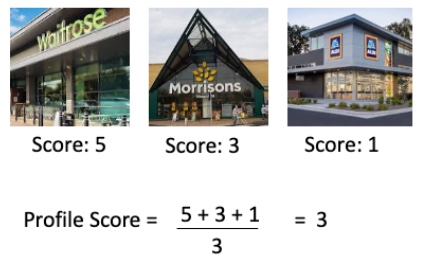

In [33]:
Image('img/profile_score.jpg')

The profile score is a new feature within the data and is intended to represent the presence of certain supermarkets within a town. The intuition behind the score is best explained with some further examples. Consider a small town where the only supermarket is a Waitrose, this would have a profile score of 5. Consider another town that only had a Lidl and an Aldi, this town would have a score of 1.

## Step 4 : Cluster the data

In [34]:
# For Dev Load Towns
towns_supermarkets = pd.read_csv('towns_supermarkets.csv')

First prepare a dataframe that contains a subset of the data

In [35]:
cluster_data = towns_supermarkets.copy();

#Remove the town, district and county
columns_to_drop = ['Location', 'Latitude', 'Longitude', 'Profile']
cluster_data.drop(columns_to_drop, inplace=True, axis=1)

In [ ]:
#from sklearn.preprocessing import StandardScaler
#import numpy as np

#cluster_data = np.nan_to_num(cluster_data)
#cluster_dataset = StandardScaler().fit_transform(cluster_data)

K-Means clustering was applied to the average property price and profile score. As the profile score is already biased to reflect the higher score of premium supermarkets, I decided to use a min/max scaler rather than a standard scaler as the standard scaler would try to represent the significance of the score in the scaled values, essentially double counting the bias I had already engineered into the profile score. 

In [36]:
from sklearn.preprocessing import MinMaxScaler
import numpy as np

scaler = MinMaxScaler()
cluster_data = np.nan_to_num(cluster_data)
#cluster_data[['Avg Price', 'Profile Score']] = scaler.fit_transform(cluster_data[['Avg Price', 'Profile Score']])
cluster_dataset = scaler.fit_transform(cluster_data)

In [37]:
# import k-means from clustering stage
from sklearn.cluster import KMeans
from sklearn import metrics 
from scipy.spatial.distance import cdist 
import matplotlib.pyplot as plt  


%matplotlib inline


K-Means is an intuitive unsupervised clustering method that tries to group the observations into a predefined number of clusters (K). To determine the optimal number of clusters I ran the algorithm several times and measured the distortion and inertia. Ideally, we are looking for a clear elbow in the graph that indicates where the distortion levels off and further clusters add little or no value.

In [38]:
# Determine optimal value for K

X = cluster_dataset

distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,10) 
  
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(X) 
    kmeanModel.fit(X)     
      
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / X.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / X.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 



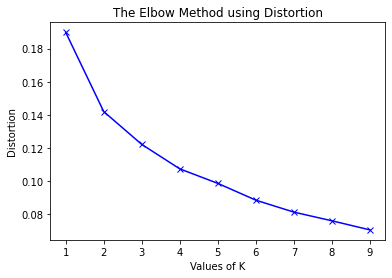

In [39]:
plt.plot(K, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show() 

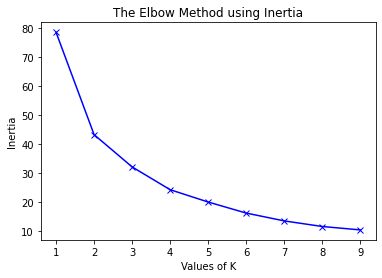

In [40]:
plt.plot(K, inertias, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Inertia') 
plt.title('The Elbow Method using Inertia') 
plt.show() 

In [ ]:
Distortion is a measure of how spread out the cluster centres are. Inertia is a measure of how closely clumped the clusters are. This analysis didn’t reveal a clear elbow, just a flattening from 4-6 on the inertia plot. As such I decided that 4 clusters would provide some new information without making the interpretation of the results overly complex.

In [41]:
# set number of clusters
kclusters = 4
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(cluster_dataset)


Insert the cluster labels into the dataset

In [42]:
final_data = towns_supermarkets.copy()

final_data.insert(0, 'Cluster Labels', kmeans.labels_)

In [43]:
final_data.head()

,Cluster Labels,Location,Avg Price,Latitude,Longitude,Profile Score,Profile
0,3,"ABERDARE, POWYS",292083,51.716154,-3.451816,2.333333,TDL
1,1,"ABERDARE, RHONDDA CYNON TAFF",128941,51.716154,-3.451816,2.333333,TDL
2,1,"ABERGAVENNY, BLAENAU GWENT",260000,51.771443,-3.245874,2.000000,TMLA
3,3,"ABERGAVENNY, CARDIFF",180000,51.822003,-3.019804,3.000000,WMA
4,3,"ABERGAVENNY, MONMOUTHSHIRE",236046,51.825366,-3.019423,3.000000,WMA


In [ ]:
final_data.to_csv('final_data_k4.csv', index=False)

# Results
With a K of 4 the clustering algorithm gave each observation a label of 0, 1,2 or 3. When plotted on a scatter plot the following clusters were revealed:

Text(0, 0.5, 'Profile Score')

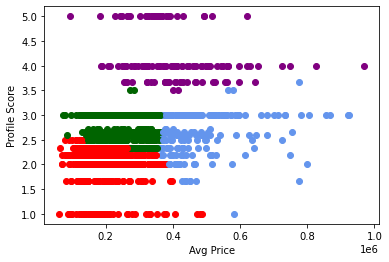

In [46]:
import matplotlib.cm as cm

my_colours = ['cornflowerblue', 'red', 'purple', 'darkgreen']

for price, score, label in zip(final_data['Avg Price'], final_data['Profile Score'], final_data['Cluster Labels']):
    plt.scatter(price, score, color=my_colours[label])

plt.xlabel('Avg Price')
plt.ylabel('Profile Score')

Understanding the results of clustering requires some interpretation and domain knowledge. Based on my understanding I drew the following conclusions from the clustering. 

* Cluster 0: Blue. High property prices, mix of all supermarkets
* Cluster 1: Red. Lower property prices, budget and mainstream supermarkets
* Cluster 2: Purple. Mid-high property prices, bias towards premium supermarkets
* Cluster 3: Green. Lower property prices, mix of all supermarkets   

What can we infer about disposable income from this analysis? The red cluster contains towns where property prices are lower than average, this alone doesn’t reveal much about income but the bias towards budget and mainstream supermarkets suggests that wages are also lower on average in these areas.

The average house price in the green cluster is no different from that in red, yet we start to see the presence of premium supermarkets which suggests wages are higher, housing costs are similar and therefore disposable income should be higher too. 

The blue cluster contains more expensive housing than green, yet the supermarket mix is very similar suggesting similar wages to those in green. If incomes are similar between blue and green then the higher housing costs incurred in blue would suggest that disposable incomes in blue are lower than those in green.   

The purple cluster has the highest presence of premium supermarkets yet a wide range of property prices too. This suggests that wages are higher in this cluster compared to other to other clusters where property prices are similar. As such, disposable incomes are highest in this cluster. 

In [47]:
!pip install folium
import folium # map rendering library

You are using pip version 19.0.3, however version 20.2b1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [48]:
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors


# create map
latitude = 53.08
longitude = 1.2

map_clusters = folium.Map(location=[latitude, longitude], zoom_start=7 )

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.coolwarm(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

my_colours = ['lightblue', 'red', 'purple', 'darkgreen']

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(final_data['Latitude'], final_data['Longitude'], final_data['Location'], final_data['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=my_colours[cluster],
        fill=True,
        fill_color=my_colours[cluster],
        fill_opacity=0.5).add_to(map_clusters)
       
map_clusters

Towns from every cluster are spread around the UK but it is clear that most towns in the blue cluster are grouped around London.

Broadly speaking the results confirm the intuition around disposable income as house prices around London are very high yet there a mix of supermarkets catering for all budgets.

# Discussion

The results produced from this analysis confirmed the intuition around disposable income, house prices and the presence of premium supermarkets. However, a number of compromises had to be accepted.

Early work with the property transaction data was done with a small subset of counties I know well. When the data was grouped to provide an average price for a town it became clear that some transactions are recorded in the wrong county. Furthermore, the same town can be represented twice if different town and district combinations are used just because of the way the data is grouped.  For example, Whychavon, Wyre Forest, Worcestershire might also be reported as Whychavon, Worcestershire, Worcestershire. As such the district feature was discarded and I relied upon Google geolocation to locate the towns.

Property sales in large cities are reported at the city level so precise locations aren’t available. This also places the centre of the search radius a long way from potential supermarkets. It should be possible to improve the accuracy of the score by basing the search radius on town population, the larger the town the greater the search radius from its centre. 

Some extra bias could be introduced for very small towns that can support a Waitrose. For example, Marlborough in Wiltshire is very small yet has a Tesco and a Waitrose.

Some premium food retailers are hard to find. I limited my search to Waitrose, Asda, Tesco, Sainsburys, Morrisons, Aldi and Lidl. I tried to include Marks and Spencer, but they are categorised as Supermarkets where they just sell food or department stores where a food supermarket is embedded into a traditional M&S department store. I was constrained by FourSquare API limits but if I was doing this for a commercial project I would augment the supermarket category search with a broader venue search in every town. I’d also widen the search to include other supermarkets such as Co-Op and Iceland.

Some food outlets, particularly from Waitrose and M&S couldn’t be described as regular supermarkets as they are found on petrol station forecourts and motorway service areas, as such these should be excluded.  

I’ve tried to simplify the supermarket landscape in the UK to keep this project manageable but there are further complexities around the feature engineering of the profile score that could be explored. The scores themselves are rather arbitrary but they could be based on some derived average price for certain common foods, such as, raw chicken, gin, sliced bread. Finally, some towns have multiple Tesco’s or Sainsbury whereas my model only counts the first occurrence.


# Conclusion

Property prices and the mix of supermarkets in a given area can be an indicator of disposable income but the clustering results require domain knowledge and are open to some interpretation. Whilst I believe my interpretation is reasonable, others are possible, especially if the number of clusters is increased.

Opportunities exist to improve the descriptive power of the model by incorporating additional features such as population data and a more exhaustive search for supermarket venues based on a wider range of supermarket chains and a more flexible search radius. The model could be extended to include the presence of certain car dealerships in an area to. Rather than looking for a Waitrose we’d also be looking for a Porsche or BMW dealership.  

It should be noted that the presence of a certain supermarket isn’t an indicator for individual shopping behaviour. Many people, myself included, will shop at a wide range of stores depending on need. It is however a reflection of the detailed analysis a supermarket chain made, perhaps many years ago, that led to an outlet opening in a particular location.  

Finally, supermarkets that were once thriving may close, new entrants such as Aldi and Lidl bring disruption. A town that could easily sustain a Waitrose or M&S may not have one because it is already saturated or has limited viable sites. The analysis that led to a store opening five years ago may give a very different result if repeated today. 


# References

[1] The Waitrose Effect. https://www.independent.co.uk/property/house-prices-latest-waitrose-effect-sainsburys-marks-and-spencer-uk-property-a7760926.html

[2] UK Property Data, free login required. https://www.kaggle.com/hm-land-registry/uk-housing-prices-paid

[3] Google Geocoding API. https://developers.google.com/maps/documentation/geocoding/start


[4] FourSquare API. https://enterprise.foursquare.com/products/places


End of notebook